<a href="https://colab.research.google.com/github/LiorGazit/Publications_and_Documents/blob/master/Demonstrating_dtale_and_pandas_profiling(colab).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# This NB demonstrates 2 awesome tools for reviewing data
1. `dtale` is meant to present DFs in a reviewable matrix.  
 [Documentation](https://github.com/man-group/dtale)
1. `pandas-profiling` generates a quick and nice exploration of the data.  
 [Documentation](https://pandas-profiling.github.io/pandas-profiling/docs/master/rtd/index.html)

## Installations
### Install `dtale`

In [1]:
try:
  import dtale
  import dtale.app as dtale_app
except:
  !pip install dtale
  import dtale
  import dtale.app as dtale_app

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


### Install `pandas-profiling`

In [2]:
try:
  import pandas as pd
  from pandas_profiling import ProfileReport
  dummy = ProfileReport(pd.DataFrame({}), title="", explorative=True)
except:
  !pip install pandas-profiling==3.0
  import pandas as pd
  from pandas_profiling import ProfileReport
  print("===\nStop and restart the session for the installation to catch!")
  import sys
  exit()

## Imports

In [3]:
import re
from sklearn.datasets import load_breast_cancer
import numpy as np
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

# 1. Analysing the Data Set: Clinicaly Significant Difference

## Get the Data Set
The dataset is described in this [README](https://github.com/jayded/evidence-inference/blob/master/annotations/README.md).  
It consists of clinical free text information with some additional attributes.   

In [12]:
dataset_raw = pd.read_csv("https://raw.githubusercontent.com/jayded/evidence-inference/master/annotations/annotations_merged.csv")
dataset_raw.head(5)

,Unnamed: 0,UserID,PromptID,PMCID,Valid Label,Valid Reasoning,Label,Annotations,Label Code,In Abstract,Evidence Start,Evidence End
0,0,0,213,2206488,True,True,no significant difference,IL-6r (ng/ml)\t\t\t\t\t\t\t Group A\t43.6 (1.7...,0,False,-1,-1
1,1,1,213,2206488,True,True,no significant difference,"There was no significant difference in IL 6, I...",0,True,1612,1708
2,2,3,213,2206488,True,True,no significant difference,"There was no significant difference in IL 6, I...",0,True,1612,1707
3,3,2,213,2206488,True,True,no significant difference,"There was no significant difference in IL 6, I...",0,True,1612,1707
4,4,0,98,2858204,True,True,significantly increased,"After two weeks of treatment, the reduction in...",1,True,18239,18338


### Creating Some Features from the Raw Data

In [13]:
dataset = dataset_raw[["Label", "Annotations"]].copy()
dataset["label_numerical"] = [int(-1 if label == "significantly decreased" else 0 if label == "no significant difference" else 1) for label in dataset_raw["Label"]]
dataset["count_of_characters"] = [round(len(str(text))/100) for text in dataset_raw["Annotations"]]
dataset["count_of_words"] = [round(len(nltk.word_tokenize(str(text)))/20) for text in dataset_raw["Annotations"]]
dataset["count_'placebo'"] = [str(text).lower().count("placebo") for text in dataset_raw["Annotations"]]
dataset["count_'mg'"] = [str(text).lower().count("mg") for text in dataset_raw["Annotations"]]
dataset["count_'%'"] = [str(text).lower().count("%") for text in dataset_raw["Annotations"]]
dataset["count_'(p'"] = [str(text).lower().count("(p") for text in dataset_raw["Annotations"]]

dataset["count_'no_significant'"] = [len(re.findall("no significant", str(text).lower())) for text in dataset_raw["Annotations"]]
dataset["count_'increase'"] = [len(re.findall("increase|greater|improve|larger|bigger", str(text).lower())) for text in dataset_raw["Annotations"]]
dataset["count_'decrease'"] = [len(re.findall("decrease|lower|worse", str(text).lower())) for text in dataset_raw["Annotations"]]

dataset = dataset.head(2000)

dataset.head(5)

,Label,Annotations,label_numerical,count_of_characters,count_of_words,count_'placebo',count_'mg',count_'%',count_'(p',count_'no_significant',count_'increase',count_'decrease'
0,no significant difference,IL-6r (ng/ml)\t\t\t\t\t\t\t Group A\t43.6 (1.7...,0,2,2,0,0,0,0,0,0,0
1,no significant difference,"There was no significant difference in IL 6, I...",0,1,1,0,0,0,0,1,0,0
2,no significant difference,"There was no significant difference in IL 6, I...",0,1,1,0,0,0,0,1,0,0
3,no significant difference,"There was no significant difference in IL 6, I...",0,1,1,0,0,0,0,1,0,0
4,significantly increased,"After two weeks of treatment, the reduction in...",1,1,1,0,0,0,1,0,0,0


## Demonstrating `dtale`

In [6]:
dtale_app.USE_COLAB = True
 
dtale.show(dataset)

2021-05-24 21:28:41,888 - INFO     - NumExpr defaulting to 2 threads.


https://zcgx7qnnbjm-496ff2e9c6d22116-40000-colab.googleusercontent.com/dtale/main/1

Reveiw the various features that `dtale` has.  
Hover over the top of the webpage and browse through the **Actions, Visualize, and Highlight** tabs.  

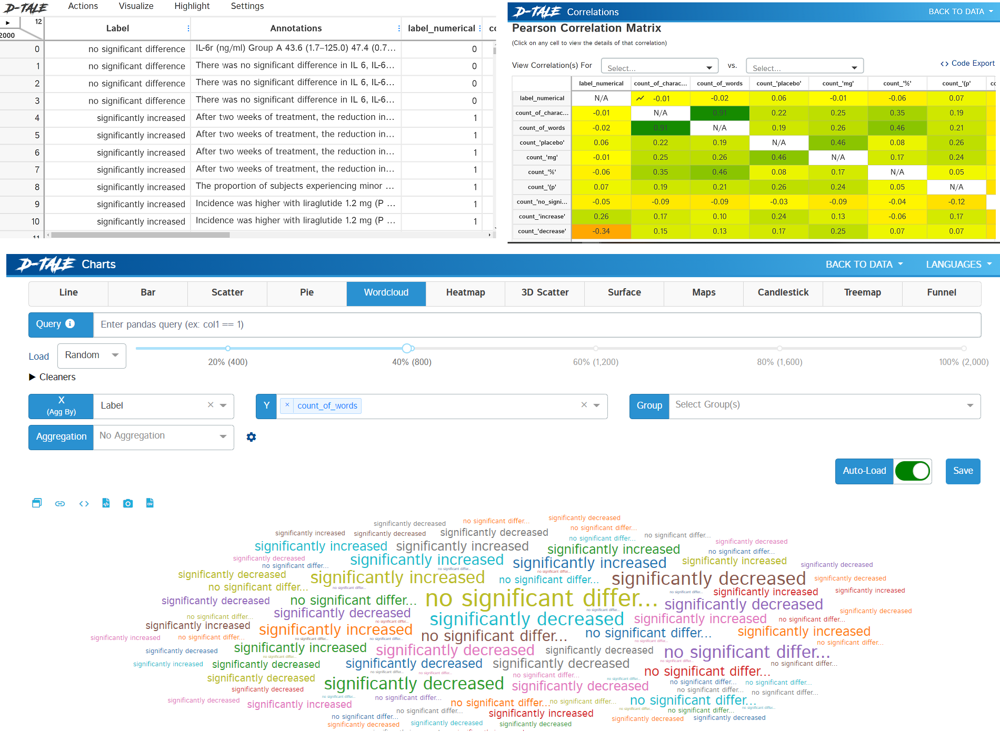

## Demonstrating `pandas-profiling`

In [7]:
profile = ProfileReport(dataset, title="Evaluating text annotations", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/25 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 2. Analysing the Data Set: Breast Cancer Data Set

## Get the Data Set
The dataset is provided with the SKLearn package.

In [14]:
raw = load_breast_cancer()
breast_cancer_table = pd.DataFrame(np.c_[raw['data'], raw['target']],
                  columns= np.append(raw['feature_names'], ['target'])).T.tail(15).T
breast_cancer_table.head(5)

,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0.0
1,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0.0
2,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0.0
3,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0.0
4,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0.0


### Creating Some Features from the Raw Data

## Demonstrating `dtale`

In [10]:
dtale_app.USE_COLAB = True
 
dtale.show(breast_cancer_table)

https://zcgx7qnnbjm-496ff2e9c6d22116-40000-colab.googleusercontent.com/dtale/main/2

Reveiw the various features that `dtale` has.  
Hover over the top of the webpage and browse through the **Actions, Visualize, and Highlight** tabs.  

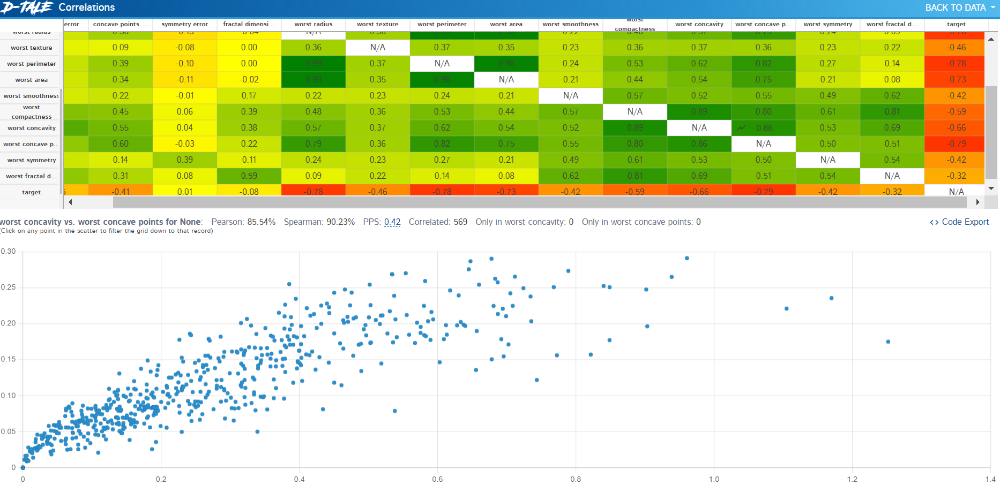

## Demonstrating `pandas-profiling`

In [11]:
profile = ProfileReport(breast_cancer_table, title="Evaluating breast_cancer_table", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]